In [1]:
import os
import shutil

def process_data_folder(data_path, folder_name):
    
    folder_path = os.path.join(data_path, folder_name)
    output_path = os.path.join("/kaggle/working", folder_name)
    images_output = os.path.join(output_path, 'images')
    labels_output = os.path.join(output_path, 'labels')
    os.makedirs(images_output, exist_ok=True)
    os.makedirs(labels_output, exist_ok=True)

    images_folder = os.path.join(folder_path, 'images')
    detections_folder = os.path.join(folder_path, 'detections')

    for subject in os.listdir(images_folder):
        subject_images_path = os.path.join(images_folder, subject)
        subject_detections_path = os.path.join(detections_folder, subject)

        if not os.path.isdir(subject_images_path):
            continue

        for image_name in os.listdir(subject_images_path):
            image_path = os.path.join(subject_images_path, image_name)
            image_id = os.path.splitext(image_name)[0]  

            new_image_name = f"{subject}_{image_id}.png"
            new_image_path = os.path.join(images_output, new_image_name)

            shutil.copy(image_path, new_image_path)

            label_file = os.path.join(subject_detections_path, f"{image_id}.txt")  
            new_label_name = f"{subject}_{image_id}.txt"  
            new_label_path = os.path.join(labels_output, new_label_name)

            if os.path.exists(label_file):
                with open(label_file, 'r') as f:
                    labels = f.readlines()

                if labels:
                    with open(new_label_path, 'w') as f:
                        f.writelines(labels)
                else:
                    print(f"Warning: The label file for {image_name} is empty. Creating empty label.")
                    open(new_label_path, 'w').close()
            else:
                open(new_label_path, 'w').close()
                print(f"Warning: No label file found for {image_name}. Creating empty label.")

    print(f"Processing of {folder_name} complete. Images saved in {images_output}, labels saved in {labels_output}.")

data_path = "/kaggle/input/computer-vision-project"
process_data_folder(data_path, 'train')
process_data_folder(data_path, 'val')

Processing of train complete. Images saved in /kaggle/working/train/images, labels saved in /kaggle/working/train/labels.
Processing of val complete. Images saved in /kaggle/working/val/images, labels saved in /kaggle/working/val/labels.


In [2]:
file_path = '/kaggle/working/train/labels/Subject_0_304.txt'

with open(file_path, 'r') as file:
    content = file.read()

print(content)

80,48,87,55



In [3]:
file_path = '/kaggle/working/train/labels/Subject_1_511.txt'

with open(file_path, 'r') as file:
    content = file.read()

print(content)

129,44,132,47
135,47,137,50



In [4]:
import os
from PIL import Image

def normalize_coordinates(image_width, image_height, xmin, ymin, xmax, ymax):
    
    x_center = (xmin + xmax) / 2 / image_width
    y_center = (ymin + ymax) / 2 / image_height
    width = (xmax - xmin) / image_width
    height = (ymax - ymin) / image_height
    return f"0 {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}"

def process_labels(labels_folder, images_folder):
   
    for label_file in os.listdir(labels_folder):
        
        label_path = os.path.join(labels_folder, label_file)
        image_name = os.path.splitext(label_file)[0] + ".png"  
        image_path = os.path.join(images_folder, image_name)
        
        if not os.path.exists(image_path):
            print(f"Image not found for {label_file}. Skipping.")
            continue
        
        with Image.open(image_path) as img:
            image_width, image_height = img.size
        
        with open(label_path, 'r') as file:
            content = file.read().strip()
        
        if content:  
            yolo_lines = []
            for line in content.splitlines():
                try:
                    xmin, ymin, xmax, ymax = map(int, line.split(','))
                    yolo_lines.append(normalize_coordinates(image_width, image_height, xmin, ymin, xmax, ymax))
                except ValueError:
                    print(f"Invalid content in {label_file}, skipping line: {line}")
            
            yolo_content = "\n".join(yolo_lines)
        else: 
            yolo_content = ""
        
        with open(label_path, 'w') as file:
            file.write(yolo_content)
        
        print(f"Processed and updated: {label_file}")

labels_folder = "/kaggle/working/train/labels"
images_folder = "/kaggle/working/train/images"

process_labels(labels_folder, images_folder)

labels_folder = "/kaggle/working/val/labels"
images_folder = "/kaggle/working/val/images"
process_labels(labels_folder, images_folder)

Processed and updated: Subject_54_136.txt
Processed and updated: Subject_0_325.txt
Processed and updated: Subject_41_133.txt
Processed and updated: Subject_33_67.txt
Processed and updated: Subject_25_375.txt
Processed and updated: Subject_0_323.txt
Processed and updated: Subject_25_359.txt
Processed and updated: Subject_3_286.txt
Processed and updated: Subject_42_106.txt
Processed and updated: Subject_44_123.txt
Processed and updated: Subject_52_101.txt
Processed and updated: Subject_10_91.txt
Processed and updated: Subject_39_126.txt
Processed and updated: Subject_16_1.txt
Processed and updated: Subject_45_147.txt
Processed and updated: Subject_37_193.txt
Processed and updated: Subject_7_12.txt
Processed and updated: Subject_21_131.txt
Processed and updated: Subject_43_166.txt
Processed and updated: Subject_25_344.txt
Processed and updated: Subject_3_276.txt
Processed and updated: Subject_43_187.txt
Processed and updated: Subject_21_123.txt
Processed and updated: Subject_13_145.txt
Pr

In [5]:
image_path = '/kaggle/working/val/images/Subject_58_301.png'
label_path = '/kaggle/working/val/labels/Subject_58_301.txt'

# show_bounding_boxes(image_path, label_path)

In [6]:
image_path = '/kaggle/working/val/images/Subject_60_50.png'
label_path = '/kaggle/working/val/labels/Subject_60_50.txt'

# show_bounding_boxes(image_path, label_path)

In [7]:
!pip install --upgrade pip

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 22.2 MB/s eta 0:00:0000:010:01
  Attempting uninstall: pip
    Found existing installation: pip 24.0
    Uninstalling pip-24.0:
      Successfully uninstalled pip-24.0


In [8]:
!pip install Ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.7/898.7 kB 20.2 MB/s eta 0:00:00


In [9]:
from ultralytics import YOLO
model= YOLO("yolo11l.pt")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 49.0M/49.0M [00:00<00:00, 218MB/s]


In [10]:
yaml_content = """
path: /kaggle/working/
train: /kaggle/working/train/images
val: /kaggle/working/val/images
test: 

nc: 1
names:
  0: 'tumor'

"""

yaml_file_path = '/kaggle/working/data.yaml'

with open(yaml_file_path, 'w') as file:
    file.write(yaml_content)

print(f"YAML configuration file saved at: {yaml_file_path}")

YAML configuration file saved at: /kaggle/working/data.yaml


In [11]:
model.train(data='/kaggle/working/data.yaml',
            epochs=100,
            imgsz=640,
            batch=32,
            device="0,1",
            workers=8,
            augment=True,
           project="logs")

Ultralytics 8.3.49 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
                                                 CUDA:1 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11l.pt, data=/kaggle/working/data.yaml, epochs=100, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=0,1, workers=8, project=logs, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf

100%|██████████| 755k/755k [00:00<00:00, 17.7MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  2   2234368  ultralytics.nn.modules.block.C3k2            [512, 512, 2, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 73.7MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/train/labels... 1832 images, 285 backgrounds, 0 corrupt: 100%|██████████| 1832/1832 [00:01<00:00, 1042.27it/s]


train: New cache created: /kaggle/working/train/labels.cache


/opt/conda/lib/python3.10/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.22 (you have 1.4.21). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /kaggle/working/val/labels... 98 images, 20 backgrounds, 0 corrupt: 100%|██████████| 98/98 [00:00<00:00, 1276.96it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: New cache created: /kaggle/working/val/labels.cache


/opt/conda/lib/python3.10/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.22 (you have 1.4.21). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


Plotting labels to logs/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to logs/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      11.2G      1.944      3.128       1.63          4        640: 100%|██████████| 58/58 [00:46<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.48it/s]


                   all         98         86      0.275      0.174      0.113     0.0497

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100        11G      1.843      1.695      1.602          8        640: 100%|██████████| 58/58 [00:46<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]


                   all         98         86    0.00155     0.0465   0.000549   0.000255

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      11.1G      1.857      1.659      1.634          8        640: 100%|██████████| 58/58 [00:49<00:00,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]


                   all         98         86      0.356      0.233      0.173     0.0748

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      11.1G      1.888      1.525      1.659          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]


                   all         98         86     0.0877      0.163     0.0275    0.00959

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      11.1G      1.861       1.47      1.594          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86     0.0314     0.0349    0.00265     0.0012

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      11.1G      1.794      1.395      1.624          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]


                   all         98         86      0.288      0.396      0.213      0.102

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      11.1G       1.81      1.339        1.6          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.427      0.451      0.406      0.179

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      11.1G       1.75      1.208      1.568          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]


                   all         98         86      0.816      0.463      0.537      0.255

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      11.1G      1.727      1.226       1.51          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]


                   all         98         86      0.735      0.384      0.462      0.283

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      11.1G      1.663      1.194      1.525          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.939      0.534      0.662      0.316

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      11.1G      1.585      1.066      1.452          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]


                   all         98         86      0.578      0.512      0.476      0.202

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      11.1G      1.575      1.058      1.463          7        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86       0.63      0.436      0.488      0.223

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      11.1G      1.585      1.035      1.502          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]


                   all         98         86      0.722      0.513      0.597       0.32

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      11.1G      1.563      1.048      1.419          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.777      0.523      0.576      0.288

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      11.1G      1.539     0.9938       1.42          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86       0.85      0.523      0.604      0.334

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      11.1G      1.503     0.9616      1.394          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.846        0.5      0.571      0.292

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      11.1G      1.459     0.9334      1.355          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.805      0.488       0.56      0.281

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      11.1G      1.465     0.9346        1.4          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.795      0.465      0.529      0.248

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      11.1G      1.499     0.9445        1.4          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.736      0.605      0.643      0.349

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      11.1G      1.442     0.8595      1.378          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.874      0.486      0.581      0.306

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      11.1G      1.423     0.8691      1.352          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]


                   all         98         86       0.76      0.628      0.602      0.272

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      11.1G      1.406     0.8609      1.326          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.875      0.568      0.654      0.338

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      11.1G       1.42     0.8588      1.338          8        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.788      0.593      0.664      0.373

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      11.1G      1.333     0.7946      1.307          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.841      0.674      0.702       0.39

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      11.1G      1.381     0.8714      1.337          2        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.854      0.523      0.581      0.306

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      11.1G      1.358     0.8382      1.302          8        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.744       0.57      0.603      0.293

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      11.1G      1.351     0.8112      1.279         11        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.778      0.651      0.668      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      11.1G      1.319     0.7826      1.296          7        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.746      0.593      0.623      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      11.1G      1.327     0.7563      1.257          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.757      0.581      0.621      0.321

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      11.1G      1.341     0.7586      1.285          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86      0.784      0.581      0.643        0.3

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      11.1G      1.326      0.761      1.259          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86       0.85      0.605      0.667      0.337

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      11.1G      1.281     0.7586      1.265          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.823      0.702      0.725      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      11.1G      1.271     0.7278      1.259          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.896      0.601      0.698      0.403

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      11.1G      1.306     0.7234      1.271          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.883      0.593      0.665      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      11.1G      1.273     0.7283       1.24          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.835      0.547      0.623      0.327

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      11.1G      1.275     0.7266      1.225          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]


                   all         98         86      0.752        0.6      0.643      0.325

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      11.1G      1.256     0.6747      1.238          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.909       0.57      0.677      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      11.1G      1.256      0.691       1.25          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.772      0.589      0.649        0.3

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      11.1G      1.191      0.643      1.216          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]


                   all         98         86       0.68      0.569      0.591      0.298

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      11.1G      1.223     0.6994       1.22          2        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.818      0.628      0.674      0.347

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      11.1G       1.19     0.6545      1.223          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.818       0.64      0.678      0.358

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      11.1G      1.193     0.6417      1.206         13        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.847      0.581      0.649      0.356

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      11.1G      1.212     0.6339        1.2          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.837      0.656      0.703      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      11.1G      1.166      0.624      1.199          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.709      0.594      0.616      0.313

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      11.1G      1.155     0.6251      1.195          3        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.751      0.666       0.67      0.331

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      11.1G      1.153     0.6263      1.195          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86      0.796      0.605      0.652      0.344

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      11.1G      1.148     0.6084      1.168          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86       0.81      0.593      0.664      0.342

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      11.1G       1.15     0.6193      1.188          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86      0.838      0.628      0.681      0.375

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      11.1G      1.178      0.624      1.197          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.819      0.558      0.639      0.348

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      11.1G      1.123     0.6117      1.193          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.834      0.628      0.681      0.354

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      11.1G      1.158     0.6149      1.184          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]


                   all         98         86      0.788       0.64      0.702      0.371

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      11.1G      1.091     0.5652       1.16          1        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.811      0.649      0.677      0.335

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      11.1G      1.076     0.5834       1.13          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]


                   all         98         86      0.865      0.671      0.721      0.389

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      11.1G      1.121     0.5816      1.158          7        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86       0.78      0.576      0.633      0.348

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      11.1G      1.121     0.5769      1.149         14        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.834       0.64      0.675      0.402

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      11.1G      1.062     0.5684      1.149          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.802      0.567       0.62      0.352

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      11.1G      1.041      0.554      1.115          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86      0.846      0.616      0.666      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      11.1G      1.068     0.5684      1.121          1        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.854      0.543      0.639       0.35

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      11.1G      1.068     0.5446      1.118          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.872       0.57       0.66       0.34

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      11.1G      1.092     0.5917      1.157          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]


                   all         98         86      0.756      0.616      0.657      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      11.1G      1.031     0.5483      1.112          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.737      0.616      0.646      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      11.1G     0.9899     0.5162      1.095          7        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]


                   all         98         86      0.775      0.558      0.653      0.375

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      11.1G     0.9853     0.5079      1.119          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]


                   all         98         86      0.874      0.593      0.668      0.393

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      11.1G       1.02     0.5298      1.109          7        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.818      0.547      0.659      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      11.1G      1.019     0.5385       1.12          3        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86      0.852      0.605      0.699      0.401

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      11.1G     0.9968     0.5144      1.106          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.844      0.558      0.642      0.363

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      11.1G      0.988     0.5059      1.085          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]


                   all         98         86      0.893      0.581      0.648       0.35

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      11.1G     0.9958     0.4977      1.081          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.864       0.59      0.679      0.345

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      11.1G      1.013     0.4977      1.102          7        640: 100%|██████████| 58/58 [00:49<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.871       0.64      0.673      0.355

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      11.1G       0.98     0.4999      1.096          2        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.822      0.646       0.67       0.36

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      11.1G     0.9535     0.4905      1.079          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86       0.82      0.605      0.701      0.391

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      11.1G      1.002     0.5113      1.086          2        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.825      0.658      0.678      0.355

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      11.1G     0.9512     0.4866      1.056          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.848      0.581      0.673      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      11.1G     0.9659     0.5037      1.075          7        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]


                   all         98         86      0.889      0.651      0.721       0.39

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      11.1G     0.9443      0.476      1.054          3        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.878      0.628        0.7      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      11.1G     0.9275     0.4703      1.047          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86       0.88      0.616       0.69       0.38

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      11.1G     0.9352     0.4828      1.055          3        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.875       0.57      0.692      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      11.1G     0.9212     0.4709      1.062          2        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.878      0.588      0.681      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      11.1G     0.9402     0.4658      1.045          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86      0.829      0.605      0.668      0.361

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      11.1G     0.8823     0.4477      1.033          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.836      0.654        0.7      0.398

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      11.1G     0.9287     0.4675      1.046          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]


                   all         98         86      0.886      0.633      0.704      0.388

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      11.1G     0.8924     0.4406      1.031          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.834      0.651      0.694      0.383

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      11.1G     0.8877     0.4456      1.031          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.847      0.651      0.708      0.394

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      11.1G      0.893     0.4607       1.04          6        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]


                   all         98         86      0.868       0.57      0.667      0.345

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      11.1G     0.9086     0.4674      1.061          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.817      0.677      0.687      0.384

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      11.1G     0.8642     0.4264      1.021          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86      0.791      0.661      0.693      0.405

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      11.1G     0.8923      0.447      1.025          2        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.801       0.64      0.689      0.394

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      11.1G     0.8567     0.4272      1.022          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.807      0.651      0.703        0.4

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      11.1G      0.815     0.4168      0.996          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86      0.838      0.661      0.707      0.375

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      11.1G     0.8291       0.41     0.9953          2        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86      0.853       0.64      0.709      0.399
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
  0%|          | 0/58 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      11.1G     0.8074     0.4057      1.032          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86       0.85      0.658      0.696      0.377

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      11.1G     0.7801     0.3886      1.037          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.883      0.614      0.688      0.384

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      11.1G     0.7819     0.3757       1.01          5        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.827      0.663       0.71      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      11.1G     0.7619      0.368      0.995          1        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


                   all         98         86      0.861      0.593      0.692      0.392

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      11.1G     0.7796     0.3741      1.014          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.835       0.64      0.704      0.384

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      11.1G     0.7658     0.3707      1.006          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


                   all         98         86      0.882      0.611      0.705      0.403

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      11.1G     0.7375     0.3556     0.9948          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.881      0.604      0.698      0.393

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      11.1G     0.7756     0.3642      1.016          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.769      0.651      0.703      0.392

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      11.1G     0.7606     0.3696      1.008          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


                   all         98         86      0.883      0.612      0.708      0.389

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      11.1G     0.7362     0.3531     0.9844          4        640: 100%|██████████| 58/58 [00:49<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]


                   all         98         86      0.873      0.605      0.692       0.39

100 epochs completed in 1.456 hours.
Optimizer stripped from logs/train/weights/last.pt, 51.2MB
Optimizer stripped from logs/train/weights/best.pt, 51.2MB

Validating logs/train/weights/best.pt...
Ultralytics 8.3.49 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
                                                 CUDA:1 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 464 layers, 25,280,083 parameters, 0 gradients, 86.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.06s/it]


                   all         98         86      0.771       0.64      0.683      0.405
Speed: 0.2ms preprocess, 40.1ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to logs/train



image 1/98 /kaggle/working/val/images/Subject_57_0.png: 640x640 (no detections), 47.5ms
image 2/98 /kaggle/working/val/images/Subject_57_1.png: 640x640 (no detections), 39.8ms
image 3/98 /kaggle/working/val/images/Subject_57_10.png: 640x640 (no detections), 38.5ms
image 4/98 /kaggle/working/val/images/Subject_57_100.png: 640x640 (no detections), 38.5ms
image 5/98 /kaggle/working/val/images/Subject_57_101.png: 640x640 (no detections), 38.6ms
image 6/98 /kaggle/working/val/images/Subject_57_201.png: 640x640 2 tumors, 37.8ms
image 7/98 /kaggle/working/val/images/Subject_57_202.png: 640x640 1 tumor, 22.7ms
image 8/98 /kaggle/working/val/images/Subject_57_203.png: 640x640 1 tumor, 24.5ms
image 9/98 /kaggle/working/val/images/Subject_57_204.png: 640x640 1 tumor, 30.6ms
image 10/98 /kaggle/working/val/images/Subject_57_205.png: 640x640 1 tumor, 30.6ms
image 11/98 /kaggle/working/val/images/Subject_57_206.png: 640x640 1 tumor, 28.7ms
image 12/98 /kaggle/working/val/images/Subject_57_207.png: 

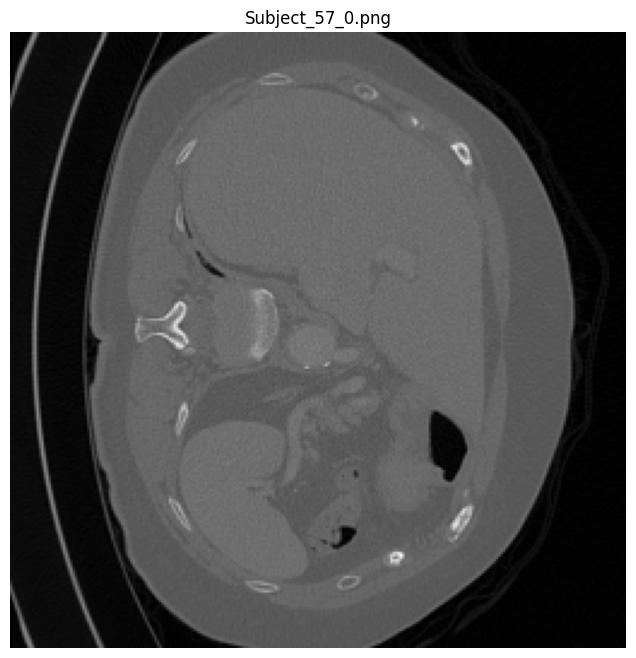

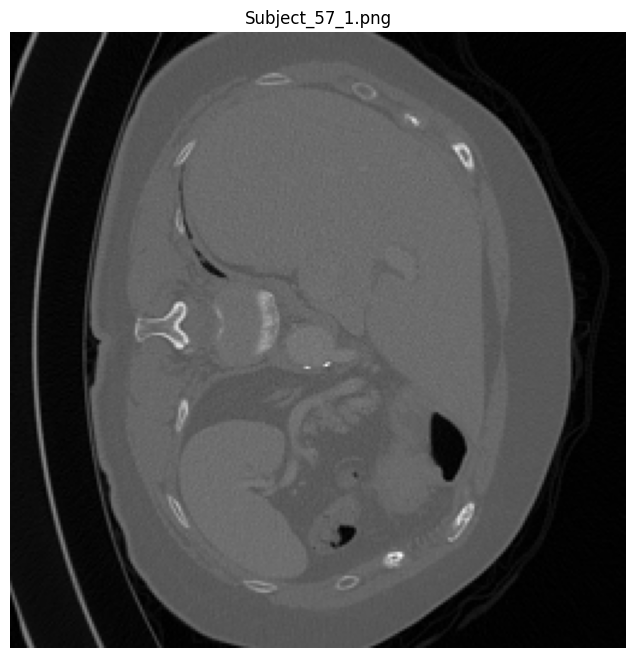

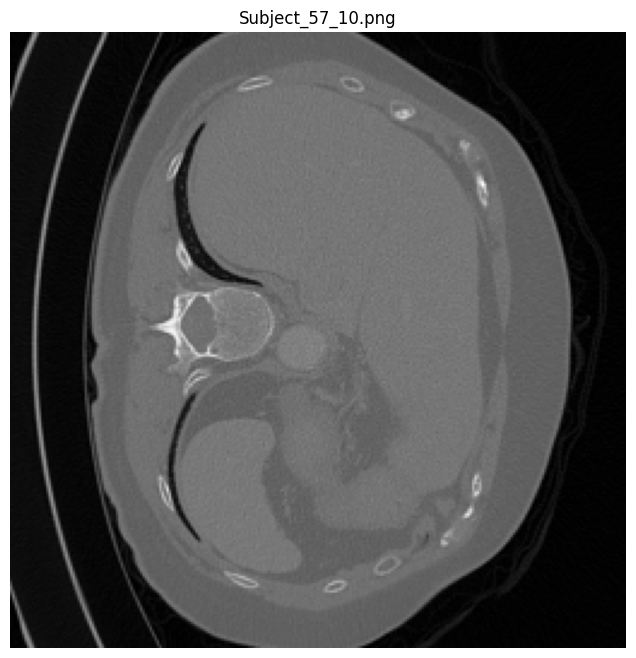

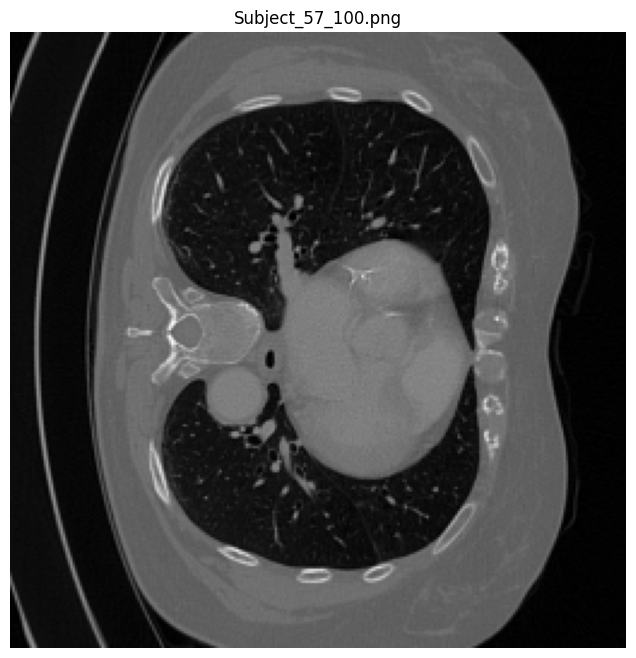

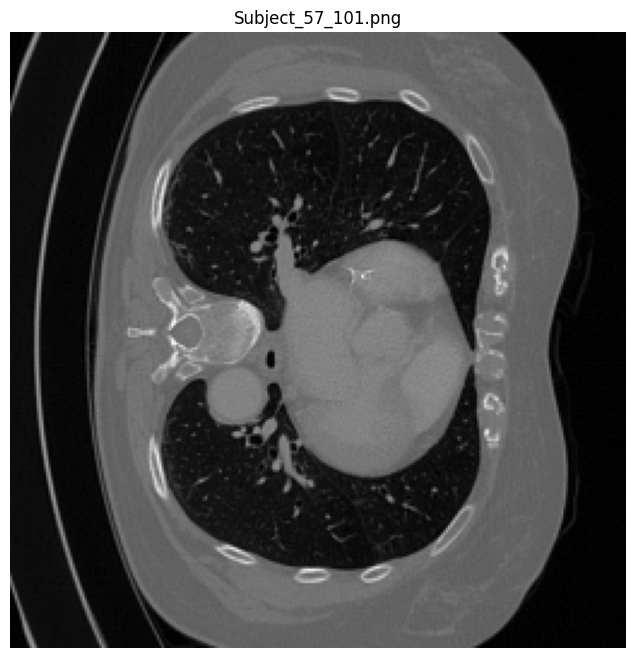

...

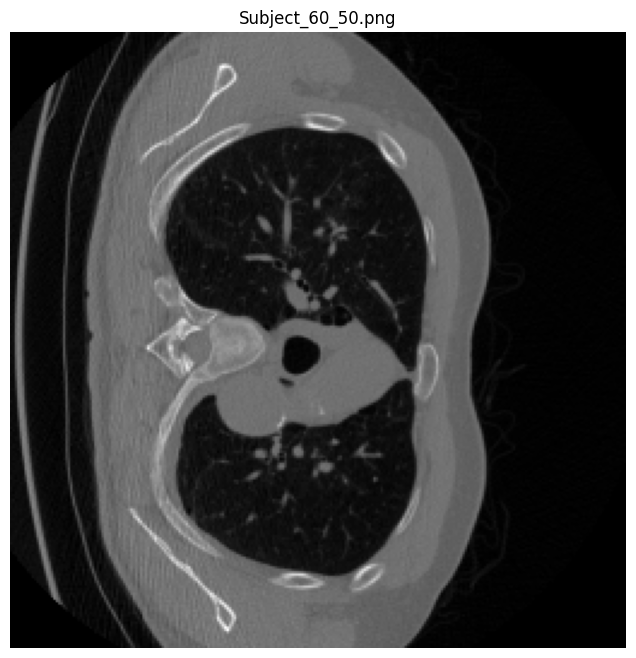

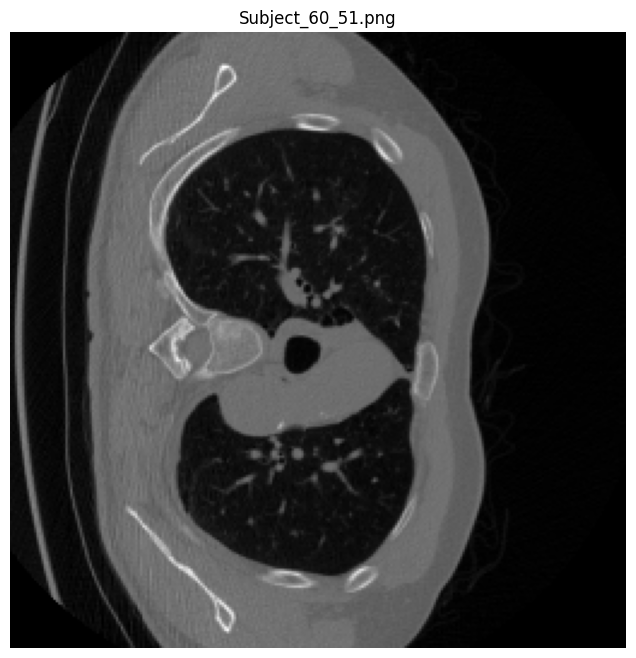

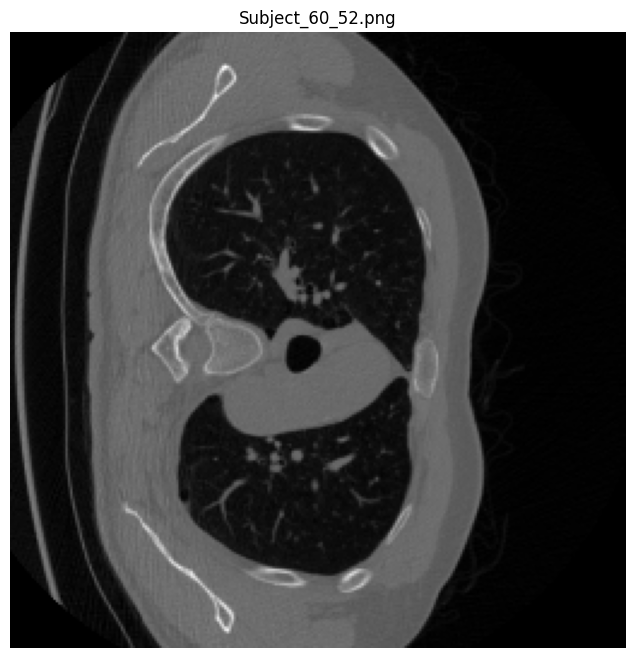

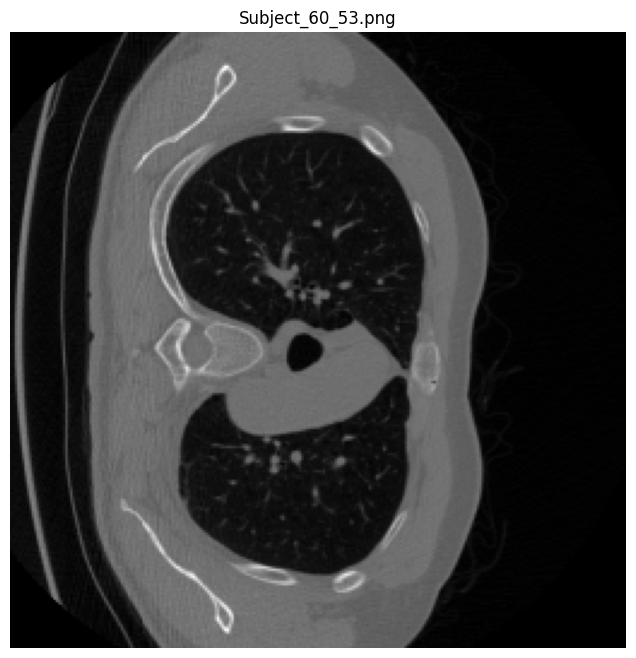

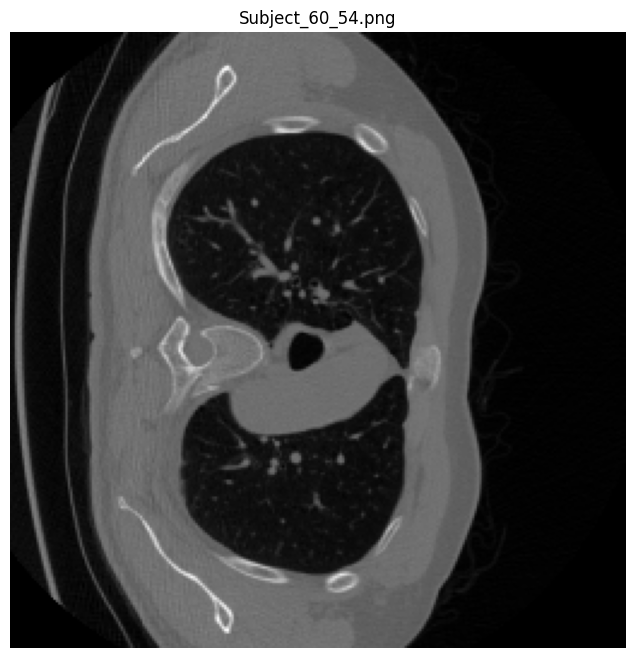

In [12]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
import os

trained_model = YOLO("/kaggle/working/logs/train/weights/best.pt")

all_results = trained_model(source="/kaggle/working/val/images" ,conf=0.2 ,save=False)

image_dir = "/kaggle/working/val/images"
image_files = sorted(os.listdir(image_dir))  

for i, result in enumerate(all_results[:]):  
    image_path = os.path.join(image_dir, image_files[i])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  

    annotated_image = result.plot()
    
    plt.figure(figsize=(8, 8))
    plt.imshow(annotated_image)
    plt.axis("off")
    plt.title(image_files[i])  
    plt.show()

In [13]:
results = model.val()
print(results)

Ultralytics 8.3.49 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
                                                 CUDA:1 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 464 layers, 25,280,083 parameters, 0 gradients, 86.6 GFLOPs


val: Scanning /kaggle/working/val/labels.cache... 98 images, 20 backgrounds, 0 corrupt: 100%|██████████| 98/98 [00:00<?, ?it/s]
/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.31s/it]


                   all         98         86      0.773       0.64      0.685      0.403
Speed: 0.3ms preprocess, 86.0ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to logs/train2
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7cba124e5cf0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,  